In [1]:
%load_ext autoreload

In [2]:
%autoreload 2

In [3]:
from master import *
from models import *

In [4]:
import ipywidgets as widgets
from ipywidgets import interact, interact_manual

In [5]:
import scipy

### Defining Parameters and Loading Trained Model

In [6]:
# !nvidia-smi

In [7]:
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
dataset='large'
ROOT_DIR = f'/beegfs/bva212/fma_{dataset}_cqt/'
PATH_TO_AUDIO_FILES = f'/beegfs/bva212/fma_{dataset}/'

PATH_FILE = 'checksums'
BATCH_SIZE = 32
VAL_SPLIT = 0.2
TRANSFORM_PROB  = 0.5
SR = 22050
MODEL_LOAD_PATH = f'/beegfs/sc6957/capstone/models/snet2_jigsaw_{dataset}_best_model.pth'
PREDS_PATH = f'/beegfs/sc6957/capstone/fma_{dataset}_valid_predictions.pkl'
MODE = 'jigsaw'
MODEL_ARCHITECTURE = 'snet2'  #['l3net','snet',snet2',anet']
SEPARABLE = False
REDUCE_TWO_CLASS = True #Applies to jigsaw (6-class to 2-class)
NUM_SECONDS=10
TRANSFORM_DATA = False

In [8]:
DEVICE

device(type='cuda', index=0)

In [9]:
start = time.time()
MODEL,MODEL_NAME = load_model(DEVICE, MODEL_ARCHITECTURE, MODE, SEPARABLE)
master = Master(DEVICE, ROOT_DIR, PATH_FILE, SR, BATCH_SIZE, VAL_SPLIT, TRANSFORM_PROB, REDUCE_TWO_CLASS, MODE, MODEL, NUM_SECONDS, TRANSFORM_DATA)
print(f'time for instantiating audio net object - {time.time() - start}')

Instantiating Model snet2_jigsaw
Number of Seconds: 10
MODE: jigsaw
Getting Train & Validation Datasets
Excluding these 3 files - ['098/098567.mp3_cqt.npy', '098/098565.mp3_cqt.npy', '098/098569.mp3_cqt.npy']
There are a total of 106410 music files in the root directory
# Training samples: 85127 	 # Validation samples: 21282
	 --Done
Creating Train & Validation Dataloaders
Length of Train dataloader: 2661 	 Validation dataloader: 666
	 --Done
	 --Done
Init actions done
time for instantiating audio net object - 37.32070779800415


In [10]:
model_save_dict = torch.load(MODEL_LOAD_PATH)
master.model.load_state_dict(model_save_dict['modelStateDict'])

<All keys matched successfully>

In [11]:
model_save_dict['modelStateDict']

OrderedDict([('conv_layers.0.weight',
              tensor([[[[ 0.0199, -0.1206,  0.0658,  0.0694, -0.1011],
                        [-0.0288, -0.1214,  0.0523, -0.0508,  0.1399],
                        [ 0.1434,  0.0132, -0.0824, -0.1276, -0.0257],
                        [-0.0549,  0.0825, -0.1674,  0.1888, -0.1556],
                        [ 0.1528, -0.0413,  0.1008,  0.0721, -0.0027]]],
              
              
                      [[[ 0.0442,  0.1702,  0.0534,  0.1146, -0.1576],
                        [ 0.1375,  0.0770,  0.0519,  0.0339,  0.0891],
                        [ 0.1760, -0.0420, -0.1091, -0.0485, -0.1295],
                        [ 0.0898, -0.0989, -0.1098,  0.1672,  0.1652],
                        [ 0.0249, -0.0238, -0.0268,  0.0970, -0.1938]]],
              
              
                      [[[-0.1591,  0.1632,  0.1992, -0.0110, -0.1594],
                        [ 0.0012, -0.0954,  0.0013,  0.0950,  0.0825],
                        [-0.0249,  0.0227,  0.

In [12]:
master.model

snet2_jigsaw(
  (conv_layers): Sequential(
    (0): Conv2d(1, 16, kernel_size=(5, 5), stride=(2, 2), padding=(5, 5))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(16, 32, kernel_size=(5, 5), stride=(2, 2), padding=(5, 5))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1), padding=(5, 5))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): AvgPool2d(kernel_size=3, stride=3, padding=0)
    (10): Conv2d(64, 128, kernel_size=(4, 4), stride=(1, 1), padding=(4, 4))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): Conv2d(128, 256, kernel_size=(4, 4), stride=(1, 1), padding=(4, 4))
    (14): BatchNorm2d(256, eps=1e-05, momentum=0.1, 

### Checking Validation Performance

In [13]:
start = time.time()
val_acc = master.evaluate_performance(compute_val = True)
print(f'time for computation - {time.time() - start}')

no of correct: 16337tion 666/666
 total: 21282

Performance computed on valid dataset over 21282 observations 
	Acc: 0.7676
time for computation - 67.00986170768738


### Getting predictions for Validation Data

In [14]:
LOAD_PREDS=True
if LOAD_PREDS:
    preds = pkl.load(open(PREDS_PATH, "rb"))
else:
    start = time.time()
    preds = master.get_predictions(phase = 'valid', save = True, preds_save_path= PREDS_PATH)
    print(f'time for fetching predictions - {time.time() - start}')

In [15]:
permutation_mappings = [
    ([0,1,2],[1,0,0,0,0,0],0),
    ([0,2,1],[0,1,0,0,0,0],1),
    ([1,0,2],[0,0,1,0,0,0],2),
    ([1,2,0],[0,0,0,1,0,0],3),
    ([2,0,1],[0,0,0,0,1,0],4),
    ([2,1,0],[0,0,0,0,0,1],5)
]

In [16]:
predictions_df = pd.DataFrame(preds, columns=['file_name', 
                                              'start_width',
                                              'chosen_perm',
                                              'y_true', 
                                              'logits', 
                                              'y_pred'])
predictions_df['probabilities'] = predictions_df.logits.apply(lambda x:scipy.special.softmax(x))
predictions_df['class_1_prob'] = predictions_df.probabilities.apply(lambda x:x[1])
predictions_df['perm_map'] = predictions_df.chosen_perm.apply(lambda x:permutation_mappings[x][0])
predictions_df.head()

,file_name,start_width,chosen_perm,y_true,logits,y_pred,probabilities,class_1_prob,perm_map
0,116/116825.mp3_cqt.npy,726,3,1,"[-1.9375046, 2.0090473]",1,"[0.018954977, 0.98104507]",0.981045,"[1, 2, 0]"
1,005/005004.mp3_cqt.npy,198,3,1,"[-0.23058724, 0.35360345]",1,"[0.3579689, 0.64203113]",0.642031,"[1, 2, 0]"
2,006/006466.mp3_cqt.npy,865,0,0,"[0.23132628, 0.081613764]",0,"[0.53735834, 0.46264163]",0.462642,"[0, 1, 2]"
3,038/038715.mp3_cqt.npy,514,0,0,"[-0.12977093, 0.66217446]",1,"[0.31175107, 0.6882489]",0.688249,"[0, 1, 2]"
4,085/085754.mp3_cqt.npy,261,4,1,"[0.25738162, -0.43720716]",0,"[0.66698694, 0.33301306]",0.333013,"[2, 0, 1]"


In [17]:
from sklearn.metrics import roc_curve, auc, confusion_matrix, accuracy_score, roc_auc_score
print(f'Validation AUC score is {roc_auc_score(predictions_df.y_true.values, predictions_df.class_1_prob.values):.4f}')
print(f'Validation Accuracy is {accuracy_score(predictions_df.y_true.values, predictions_df.y_pred.values):.4f}')
print(f'Number of correct classifications is {accuracy_score(predictions_df.y_true.values, predictions_df.y_pred.values,normalize=False):.4f}')

Validation AUC score is 0.8620
Validation Accuracy is 16403.0000


### Correct Classified Examples Analysis

In [18]:
correct_preds = predictions_df[['file_name',
                                  'start_width',
                                'chosen_perm',
                                  'y_true', 
                                  'y_pred', 
                                  'class_1_prob',
                               'perm_map']][predictions_df.y_true == predictions_df.y_pred]

In [19]:
correct_jigsaw_with_hc = correct_preds.sort_values(by = ['y_pred', 'class_1_prob'], 
                                             axis = 0,
                                             ascending = [False, False])

In [20]:
correct_jigsaw_with_hc.head(10)

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map
6011,116/116435.mp3_cqt.npy,389,5,1,1,1.000000,"[2, 1, 0]"
7463,017/017194.mp3_cqt.npy,131,4,1,1,0.999998,"[2, 0, 1]"
2358,154/154307.mp3_cqt.npy,768,2,1,1,0.999997,"[1, 0, 2]"
20786,125/125288.mp3_cqt.npy,520,5,1,1,0.999996,"[2, 1, 0]"
10069,021/021355.mp3_cqt.npy,372,4,1,1,0.999995,"[2, 0, 1]"
3902,039/039443.mp3_cqt.npy,284,2,1,1,0.999995,"[1, 0, 2]"
1000,040/040410.mp3_cqt.npy,583,2,1,1,0.999994,"[1, 0, 2]"
15574,106/106176.mp3_cqt.npy,206,2,1,1,0.999992,"[1, 0, 2]"
1224,133/133158.mp3_cqt.npy,156,4,1,1,0.999990,"[2, 0, 1]"
20592,092/092756.mp3_cqt.npy,342,1,1,1,0.999989,"[0, 2, 1]"


In [21]:
correct_normal_with_hc = correct_preds.sort_values(by = ['y_pred', 'class_1_prob'], 
                                                 axis = 0,
                                                 ascending = [True, True])
correct_normal_with_hc.head(10)

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map
18693,025/025721.mp3_cqt.npy,175,0,0,0,0.000502,"[0, 1, 2]"
75,112/112781.mp3_cqt.npy,597,0,0,0,0.000770,"[0, 1, 2]"
11454,087/087518.mp3_cqt.npy,602,0,0,0,0.001463,"[0, 1, 2]"
16370,151/151521.mp3_cqt.npy,669,0,0,0,0.001824,"[0, 1, 2]"
4514,060/060083.mp3_cqt.npy,100,0,0,0,0.001924,"[0, 1, 2]"
5797,126/126590.mp3_cqt.npy,281,0,0,0,0.001953,"[0, 1, 2]"
17862,098/098228.mp3_cqt.npy,636,0,0,0,0.002260,"[0, 1, 2]"
1905,073/073976.mp3_cqt.npy,209,0,0,0,0.002299,"[0, 1, 2]"
1318,039/039667.mp3_cqt.npy,483,0,0,0,0.002322,"[0, 1, 2]"
10012,033/033350.mp3_cqt.npy,786,0,0,0,0.002522,"[0, 1, 2]"


### Visualizing Correct Classified Examples

#### Examples which are jigsawed. Correctly classified with high confidence

In [35]:
correct_jigsaw_with_hc.head()

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map
6011,116/116435.mp3_cqt.npy,389,5,1,1,1.000000,"[2, 1, 0]"
7463,017/017194.mp3_cqt.npy,131,4,1,1,0.999998,"[2, 0, 1]"
2358,154/154307.mp3_cqt.npy,768,2,1,1,0.999997,"[1, 0, 2]"
20786,125/125288.mp3_cqt.npy,520,5,1,1,0.999996,"[2, 1, 0]"
10069,021/021355.mp3_cqt.npy,372,4,1,1,0.999995,"[2, 0, 1]"


For all the below examples true label is 1 (jigsaw)  and the model predicts them as 1 (jigsaw) with high confidence

----------------------------------------------------------------------------------------------------
116/116435.mp3_cqt.npy    start second is 9.12    confidence is 1.0000


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [2, 1, 0]
Complete Jigsaw Piece


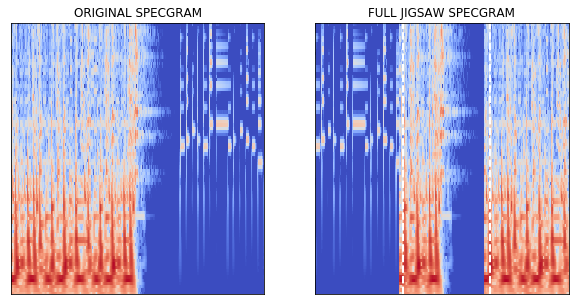

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
017/017194.mp3_cqt.npy    start second is 3.07    confidence is 1.0000


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [2, 0, 1]
Complete Jigsaw Piece


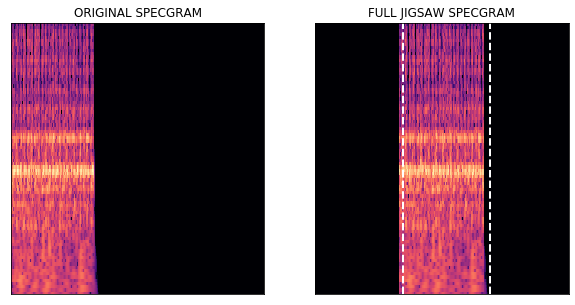

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
154/154307.mp3_cqt.npy    start second is 18.00    confidence is 1.0000


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [1, 0, 2]
Complete Jigsaw Piece


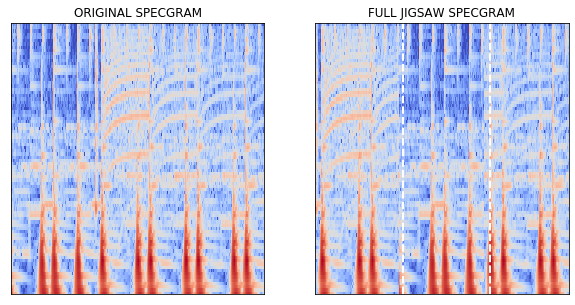

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
125/125288.mp3_cqt.npy    start second is 12.19    confidence is 1.0000


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [2, 1, 0]
Complete Jigsaw Piece


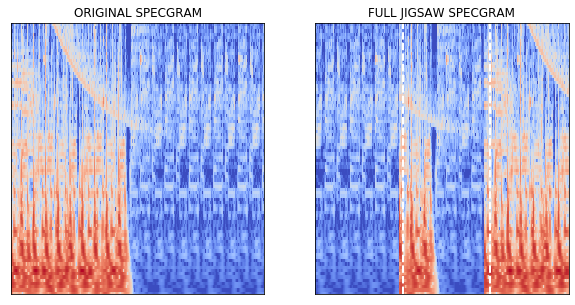

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
021/021355.mp3_cqt.npy    start second is 8.72    confidence is 1.0000


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [2, 0, 1]
Complete Jigsaw Piece


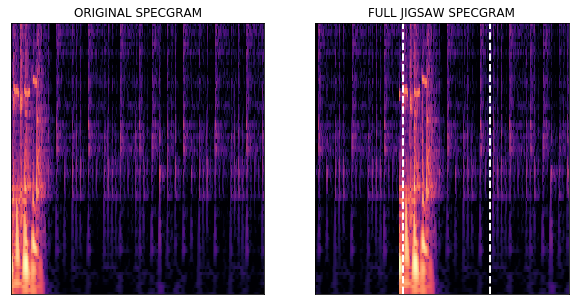

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

In [36]:
print('For all the below examples true label is 1 (jigsaw)  and the model predicts them as 1 (jigsaw) with high confidence\n')
num_examples_to_show = 10
for i in range(5):
    print('-'*100)
    print(f"{correct_jigsaw_with_hc['file_name'].iloc[i]}\
    start second is {correct_jigsaw_with_hc['start_width'].iloc[i]/1280 * 30:.2f}\
    confidence is {correct_jigsaw_with_hc['class_1_prob'].iloc[i]:.4f}")
          
    start_width = correct_jigsaw_with_hc['start_width'].iloc[i]
    if start_width >=850:
        start_width=850
        print(f'Actual Start Second: {start_width/1280 * 30:.2f}')
    perm_map = correct_jigsaw_with_hc['perm_map'].iloc[i]
    waveform, _ = librosa.load(PATH_TO_AUDIO_FILES + correct_jigsaw_with_hc['file_name'].iloc[i][:-8], sr = SR)
    obj = ipd.Audio(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)], rate=SR)
    print()
    print('Original')
    ipd.display(obj)
    print('Jigsaw')
    print(f'Permutation: {perm_map}')
    chosen_split = waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)]
#    print(start_width)
#     print(int(start_width*30/1280*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR) - int(start_width*30/1280*SR) +1)
#    print(waveform.shape)
#     print(chosen_split.shape)
    while len(chosen_split)%3 !=0:
        chosen_split=np.append(chosen_split,0)
    jigsaw_splits = [np.split(chosen_split, 3)][0]
    waveform_jigsaws = np.array([jigsaw_splits[x] for x in perm_map])

    print('Complete Jigsaw Piece')      
    waveform_jigsaw = np.concatenate(waveform_jigsaws)
#     print(waveform_jigsaw.shape)
    waveform_jigsaw = np.ascontiguousarray(waveform_jigsaw, dtype=np.float32)
    jigsaw_obj = ipd.Audio(waveform_jigsaw, rate=SR)
    ipd.display(jigsaw_obj)
    master.visualize_cqts(correct_jigsaw_with_hc['file_name'].iloc[i], 
                           start_width = start_width, perm_map=perm_map, display= True, figsize=(10,5))
          
    @interact
    def return_piece(i=range(3)):
          #for i,piece in enumerate(waveform_jigsaws):
          print(f'Position in Jigsaw {i}\nPosition in Original {perm_map[i]}')
          waveform_piece = np.ascontiguousarray(waveform_jigsaws[i], dtype=np.float32)
          waveform_piece_obj = ipd.Audio(waveform_piece, rate=SR)
          ipd.display(waveform_piece_obj)

#### Examples which are not jigsawed. Correctly classified with high confidence

In [37]:
correct_normal_with_hc.head()

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map
18693,025/025721.mp3_cqt.npy,175,0,0,0,0.000502,"[0, 1, 2]"
75,112/112781.mp3_cqt.npy,597,0,0,0,0.000770,"[0, 1, 2]"
11454,087/087518.mp3_cqt.npy,602,0,0,0,0.001463,"[0, 1, 2]"
16370,151/151521.mp3_cqt.npy,669,0,0,0,0.001824,"[0, 1, 2]"
4514,060/060083.mp3_cqt.npy,100,0,0,0,0.001924,"[0, 1, 2]"


For all the below examples true label is 0 (not jigsawed) and the model predicts them as not jigsawed with high confidence

----------------------------------------------------------------------------------------------------
025/025721.mp3_cqt.npy    start second is 4.10    confidence is 0.0005


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


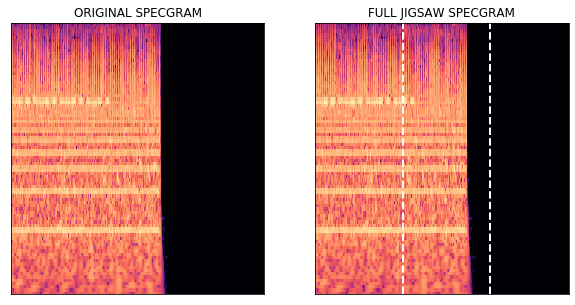

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
112/112781.mp3_cqt.npy    start second is 13.99    confidence is 0.0008


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


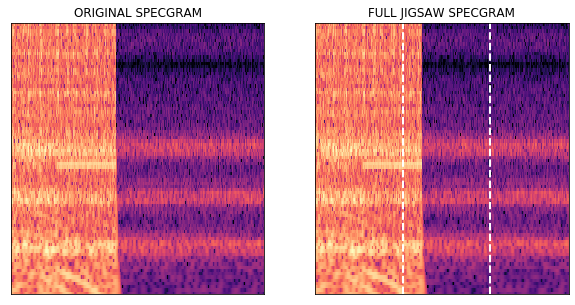

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
087/087518.mp3_cqt.npy    start second is 14.11    confidence is 0.0015


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


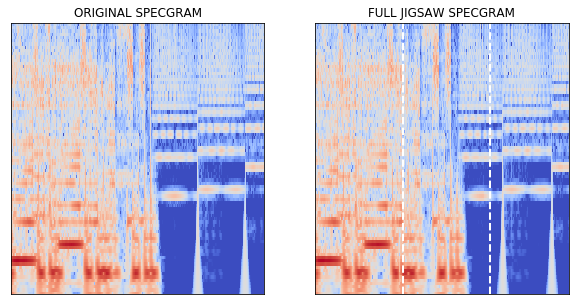

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
151/151521.mp3_cqt.npy    start second is 15.68    confidence is 0.0018


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


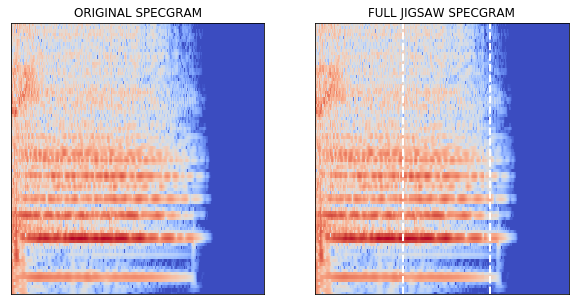

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
060/060083.mp3_cqt.npy    start second is 2.34    confidence is 0.0019


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


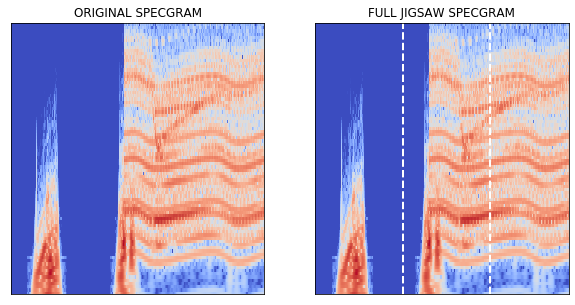

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

In [38]:
print('For all the below examples true label is 0 (not jigsawed) and the model predicts them as not jigsawed with high confidence\n')
num_examples_to_show = 10
for i in range(5):
    print('-'*100)
    print(f"{correct_normal_with_hc['file_name'].iloc[i]}\
    start second is {correct_normal_with_hc['start_width'].iloc[i]/1280 * 30:.2f}\
    confidence is {correct_normal_with_hc['class_1_prob'].iloc[i]:.4f}")
#     logscalogram = np.load(ROOT_DIR + correct_normal_with_hc['file_name'].iloc[i])      
    start_width = correct_normal_with_hc['start_width'].iloc[i]
    if start_width >=850:
        start_width=850
#     desired_width=420
        print(f'Actual Start Second: {start_width/1280 * 30:.2f}')
#     print(f'Desired End Second: {(start_width+desired_width)/1280 * 30:.2f}')
    
    perm_map = correct_normal_with_hc['perm_map'].iloc[i]
    waveform, _ = librosa.load(PATH_TO_AUDIO_FILES + correct_normal_with_hc['file_name'].iloc[i][:-8], sr = SR)
#     print(f'Total seconds: {logscalogram.shape[1]*30/1280}')
#     obj = ipd.Audio(waveform, rate=SR)
#     print('Total clip')
#     ipd.display(obj)
    obj = ipd.Audio(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)], rate=SR)
    print()
    print('Original')
    ipd.display(obj)
    print('Jigsaw')
    print(f'Permutation: {perm_map}')
    chosen_split = waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)]
#     print(start_width)
#     print(int(start_width*30/1280*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR) - int(start_width*30/1280*SR) +1)
#     print(waveform.shape)
#     print(chosen_split.shape)
    while len(chosen_split)%3 !=0:
        chosen_split=np.append(chosen_split,0)
    jigsaw_splits = [np.split(chosen_split, 3)][0]
    waveform_jigsaws = np.array([jigsaw_splits[x] for x in perm_map])

    print('Complete Jigsaw Piece')      
    waveform_jigsaw = np.concatenate(waveform_jigsaws)
#     print(waveform_jigsaw.shape)
    waveform_jigsaw = np.ascontiguousarray(waveform_jigsaw, dtype=np.float32)
    jigsaw_obj = ipd.Audio(waveform_jigsaw, rate=SR)
    ipd.display(jigsaw_obj)
    master.visualize_cqts(correct_normal_with_hc['file_name'].iloc[i], 
                           start_width = start_width, perm_map=perm_map, display= True, figsize=(10,5))
          
    @interact
    def return_piece(i=range(3)):
          #for i,piece in enumerate(waveform_jigsaws):
          print(f'Position in Jigsaw {i}\nPosition in Original {perm_map[i]}')
          waveform_piece = np.ascontiguousarray(waveform_jigsaws[i], dtype=np.float32)
          waveform_piece_obj = ipd.Audio(waveform_piece, rate=SR)
          ipd.display(waveform_piece_obj)

(84, 601)
175
595
(84, 420)


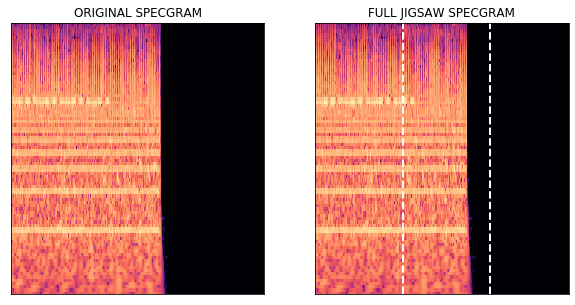

In [39]:
def visualize_cqts(filename, start_width, perm_map,  display=True, figsize=(10,5)):

    logscalogram = np.load(ROOT_DIR + filename)
    print(logscalogram.shape)
    second_width = int(1280/30)
    desired_width = NUM_SECONDS * second_width
    print(start_width)
    print(start_width + desired_width)
    chosen_split = logscalogram[:, start_width: start_width + desired_width]
    print(chosen_split.shape)
    height = logscalogram.shape[0]
    fig, ax = plt.subplots(1, 2, sharex='col', sharey='row', figsize=figsize)
    if display:
        ax[0].set_title('ORIGINAL SPECGRAM')
        specshow(chosen_split,ax=ax[0])
    jigsaw_splits = [np.split(chosen_split, 3, axis=1)][0] 
    final_jigsaw = np.concatenate(np.array([jigsaw_splits[x][:,:-5] for x in perm_map]), axis=1)
    if display:
        ax[1].set_title('FULL JIGSAW SPECGRAM')
        jigsaw_xs = (desired_width * np.array([1, 2, 3]) / 3).astype('int')
        for jigsaw_x in jigsaw_xs:
            plt.plot([jigsaw_x, jigsaw_x], [0, height],'--', color='w', linewidth=2.0)
        specshow(final_jigsaw,ax=ax[1])
        plt.show()
    return

visualize_cqts('025/025721.mp3_cqt.npy',175,[0, 1, 2])

### Incorrect Classified Examples Analysis

In [40]:
incorrect_preds = predictions_df[['file_name',
                                  'start_width',
                                  'chosen_perm',
                                  'y_true', 
                                  'y_pred', 
                                  'class_1_prob',
                                 'perm_map']][predictions_df.y_true != predictions_df.y_pred]

#### Incorrectly classified not jigsaw as jigsaw classified with high confidence

In [41]:
incorr_not_jigsaw_with_hc = incorrect_preds.sort_values(by = ['y_pred', 'class_1_prob'], 
                                                 axis = 0,
                                                 ascending = [False, False])
incorr_not_jigsaw_with_hc.head(10)

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map
2125,017/017577.mp3_cqt.npy,204,0,0,1,0.973618,"[0, 1, 2]"
17067,023/023807.mp3_cqt.npy,755,0,0,1,0.972529,"[0, 1, 2]"
19947,081/081253.mp3_cqt.npy,30,0,0,1,0.971641,"[0, 1, 2]"
19754,033/033028.mp3_cqt.npy,205,0,0,1,0.966207,"[0, 1, 2]"
4989,083/083944.mp3_cqt.npy,758,0,0,1,0.962120,"[0, 1, 2]"
7152,016/016325.mp3_cqt.npy,669,0,0,1,0.961470,"[0, 1, 2]"
16795,032/032487.mp3_cqt.npy,400,0,0,1,0.961041,"[0, 1, 2]"
13909,099/099656.mp3_cqt.npy,673,0,0,1,0.953802,"[0, 1, 2]"
9072,072/072655.mp3_cqt.npy,707,0,0,1,0.948349,"[0, 1, 2]"
12936,127/127224.mp3_cqt.npy,715,0,0,1,0.947230,"[0, 1, 2]"


#### Incorrectly classified jigsaw as not jigsaw classified with high confidence

In [42]:
incorr_jigsaw_with_hc = incorrect_preds.sort_values(by = ['y_pred', 'class_1_prob'], 
                                                 axis = 0,
                                                 ascending = [True, True])
incorr_jigsaw_with_hc.head(10)

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map
19728,130/130436.mp3_cqt.npy,29,1,1,0,0.014843,"[0, 2, 1]"
7135,086/086216.mp3_cqt.npy,399,1,1,0,0.020499,"[0, 2, 1]"
2504,043/043098.mp3_cqt.npy,837,2,1,0,0.027749,"[1, 0, 2]"
19962,082/082722.mp3_cqt.npy,445,2,1,0,0.032968,"[1, 0, 2]"
1658,071/071042.mp3_cqt.npy,792,2,1,0,0.035313,"[1, 0, 2]"
293,024/024420.mp3_cqt.npy,467,1,1,0,0.037364,"[0, 2, 1]"
13708,123/123631.mp3_cqt.npy,349,1,1,0,0.037828,"[0, 2, 1]"
6040,119/119586.mp3_cqt.npy,774,4,1,0,0.042690,"[2, 0, 1]"
2417,053/053692.mp3_cqt.npy,54,1,1,0,0.043504,"[0, 2, 1]"
11776,084/084285.mp3_cqt.npy,228,2,1,0,0.045912,"[1, 0, 2]"


### Visualizing Incorrect Classified Examples

#### Examples which are not jigsawed. Incorrectly classified with high confidence

In [43]:
incorr_not_jigsaw_with_hc.head()

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map
2125,017/017577.mp3_cqt.npy,204,0,0,1,0.973618,"[0, 1, 2]"
17067,023/023807.mp3_cqt.npy,755,0,0,1,0.972529,"[0, 1, 2]"
19947,081/081253.mp3_cqt.npy,30,0,0,1,0.971641,"[0, 1, 2]"
19754,033/033028.mp3_cqt.npy,205,0,0,1,0.966207,"[0, 1, 2]"
4989,083/083944.mp3_cqt.npy,758,0,0,1,0.962120,"[0, 1, 2]"


For all the below examples true label is 0 (not jigsawed) and the model predicts them as jigsawed (1) with high confidence

----------------------------------------------------------------------------------------------------
017/017577.mp3_cqt.npy    start second is 4.78    confidence is 0.9736


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


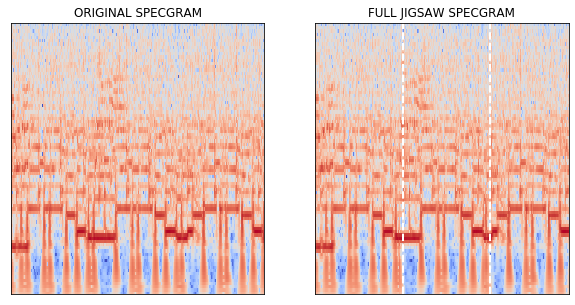

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
023/023807.mp3_cqt.npy    start second is 17.70    confidence is 0.9725


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


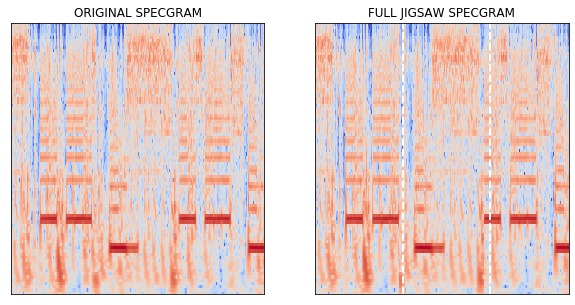

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
081/081253.mp3_cqt.npy    start second is 0.70    confidence is 0.9716


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


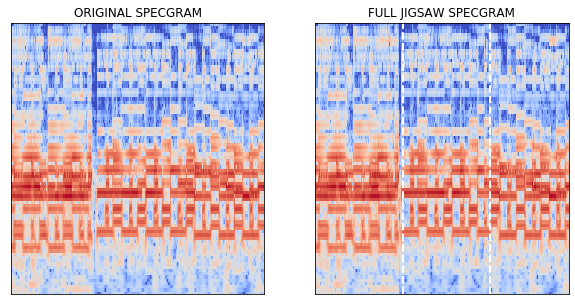

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
033/033028.mp3_cqt.npy    start second is 4.80    confidence is 0.9662


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


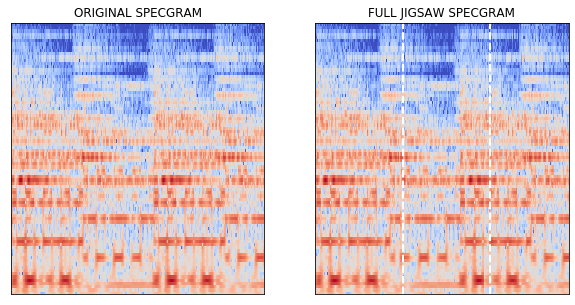

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
083/083944.mp3_cqt.npy    start second is 17.77    confidence is 0.9621


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
Complete Jigsaw Piece


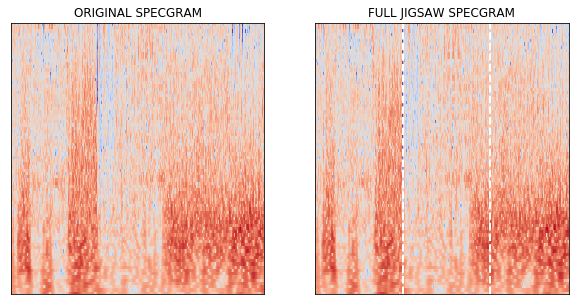

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

In [44]:
print('For all the below examples true label is 0 (not jigsawed) and the model predicts them as jigsawed (1) with high confidence\n')
num_examples_to_show = 10
for i in range(5):
    print('-'*100)
    print(f"{incorr_not_jigsaw_with_hc['file_name'].iloc[i]}\
    start second is {incorr_not_jigsaw_with_hc['start_width'].iloc[i]/1280 * 30:.2f}\
    confidence is {incorr_not_jigsaw_with_hc['class_1_prob'].iloc[i]:.4f}")
          
    start_width = incorr_not_jigsaw_with_hc['start_width'].iloc[i]
    if start_width >=850:
        start_width=850
#         desired_width=420
        print(f'Actual Start Second: {start_width/1280 * 30:.2f}')
#         print(f'Desired End Second: {(start_width+desired_width)/1280 * 30:.2f}')
    perm_map = incorr_not_jigsaw_with_hc['perm_map'].iloc[i]
    waveform, _ = librosa.load(PATH_TO_AUDIO_FILES + incorr_not_jigsaw_with_hc['file_name'].iloc[i][:-8], sr = SR)
    obj = ipd.Audio(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)], rate=SR)
    print()
    print('Original')
    ipd.display(obj)
    print('Jigsaw')
    print(f'Permutation: {perm_map}')
    chosen_split = waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)]
#    print(start_width)
#     print(int(start_width*30/1280*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR) - int(start_width*30/1280*SR) +1)
#     print(chosen_split.shape)
    while len(chosen_split)%3 !=0:
        chosen_split=np.append(chosen_split,0)
    jigsaw_splits = [np.split(chosen_split, 3)][0]
    waveform_jigsaws = np.array([jigsaw_splits[x] for x in perm_map])

    print('Complete Jigsaw Piece')      
    waveform_jigsaw = np.concatenate(waveform_jigsaws)
#     print(waveform_jigsaw.shape)
    waveform_jigsaw = np.ascontiguousarray(waveform_jigsaw, dtype=np.float32)
    jigsaw_obj = ipd.Audio(waveform_jigsaw, rate=SR)
    ipd.display(jigsaw_obj)
    master.visualize_cqts(incorr_not_jigsaw_with_hc['file_name'].iloc[i], 
                           start_width = start_width, perm_map=perm_map, display= True, figsize=(10,5))
          
    @interact
    def return_piece(i=range(3)):
          #for i,piece in enumerate(waveform_jigsaws):
          print(f'Position in Jigsaw {i}\nPosition in Original {perm_map[i]}')
          waveform_piece = np.ascontiguousarray(waveform_jigsaws[i], dtype=np.float32)
          waveform_piece_obj = ipd.Audio(waveform_piece, rate=SR)
          ipd.display(waveform_piece_obj)

#### Examples which are jigsawed. Incorrectly classified with high confidence

In [45]:
incorr_jigsaw_with_hc.head()

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map
19728,130/130436.mp3_cqt.npy,29,1,1,0,0.014843,"[0, 2, 1]"
7135,086/086216.mp3_cqt.npy,399,1,1,0,0.020499,"[0, 2, 1]"
2504,043/043098.mp3_cqt.npy,837,2,1,0,0.027749,"[1, 0, 2]"
19962,082/082722.mp3_cqt.npy,445,2,1,0,0.032968,"[1, 0, 2]"
1658,071/071042.mp3_cqt.npy,792,2,1,0,0.035313,"[1, 0, 2]"


For all the below examples true label is 1 ( jigsawed) and the model predicts them as not jigsawed (0) with high confidence

----------------------------------------------------------------------------------------------------
130/130436.mp3_cqt.npy    start second is 0.68    confidence is 0.0148


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 2, 1]
Complete Jigsaw Piece


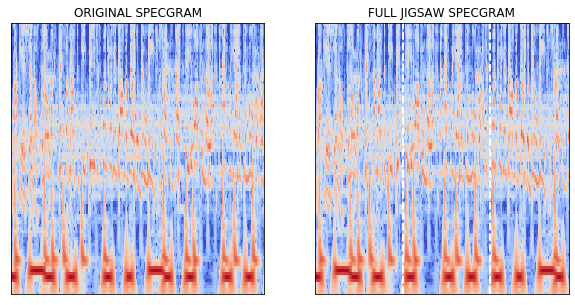

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
086/086216.mp3_cqt.npy    start second is 9.35    confidence is 0.0205


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 2, 1]
Complete Jigsaw Piece


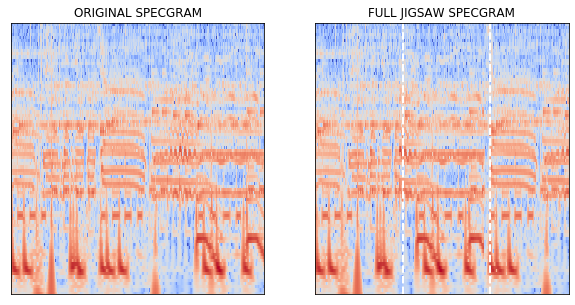

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
043/043098.mp3_cqt.npy    start second is 19.62    confidence is 0.0277


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [1, 0, 2]
Complete Jigsaw Piece


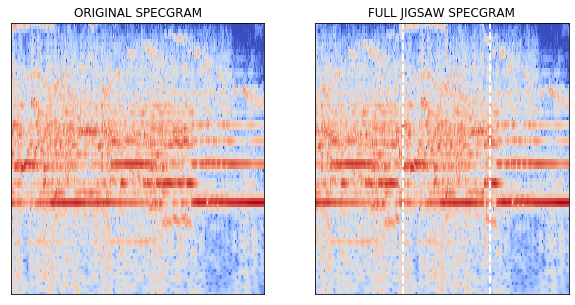

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
082/082722.mp3_cqt.npy    start second is 10.43    confidence is 0.0330


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [1, 0, 2]
Complete Jigsaw Piece


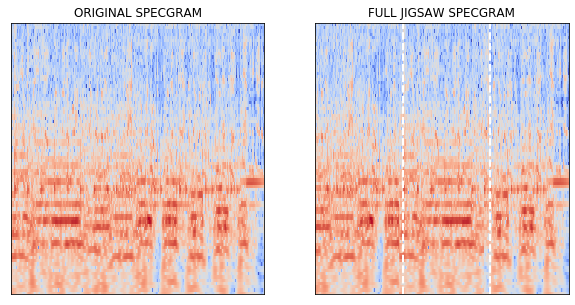

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
071/071042.mp3_cqt.npy    start second is 18.56    confidence is 0.0353


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [1, 0, 2]
Complete Jigsaw Piece


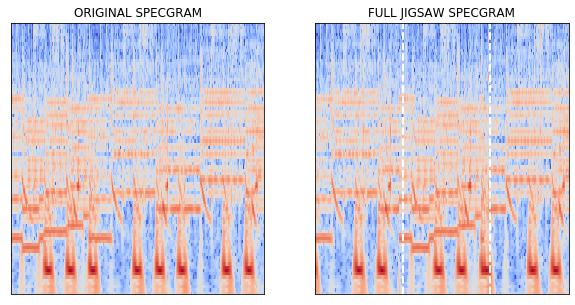

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

In [46]:
print('For all the below examples true label is 1 ( jigsawed) and the model predicts them as not jigsawed (0) with high confidence\n')
num_examples_to_show = 10
for i in range(5):

    print('-'*100)
    print(f"{incorr_jigsaw_with_hc['file_name'].iloc[i]}\
    start second is {incorr_jigsaw_with_hc['start_width'].iloc[i]/1280 * 30:.2f}\
    confidence is {incorr_jigsaw_with_hc['class_1_prob'].iloc[i]:.4f}")
          
    start_width = incorr_jigsaw_with_hc['start_width'].iloc[i]
    if start_width >=850:
        start_width=850
        print(f'Actual Start Second: {start_width/1280 * 30:.2f}')
    perm_map = incorr_jigsaw_with_hc['perm_map'].iloc[i]
    waveform, _ = librosa.load(PATH_TO_AUDIO_FILES + incorr_jigsaw_with_hc['file_name'].iloc[i][:-8], sr = SR)
    obj = ipd.Audio(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)], rate=SR)
    print()
    print('Original')
    ipd.display(obj)
    print('Jigsaw')
    print(f'Permutation: {perm_map}')
    chosen_split = waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)]
#     print(waveform.shape)
#     print(start_width)
#     print(int(start_width*30/1280*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR) - int(start_width*30/1280*SR) +1)
#     print(chosen_split.shape)
    while len(chosen_split)%3 !=0:
        chosen_split=np.append(chosen_split,0)
    jigsaw_splits = [np.split(chosen_split, 3)][0]
    waveform_jigsaws = np.array([jigsaw_splits[x] for x in perm_map])

    print('Complete Jigsaw Piece')      
    waveform_jigsaw = np.concatenate(waveform_jigsaws)
#     print(waveform_jigsaw.shape)
    waveform_jigsaw = np.ascontiguousarray(waveform_jigsaw, dtype=np.float32)
    jigsaw_obj = ipd.Audio(waveform_jigsaw, rate=SR)
    ipd.display(jigsaw_obj)
    master.visualize_cqts(incorr_jigsaw_with_hc['file_name'].iloc[i], 
                           start_width = start_width, perm_map=perm_map, display= True, figsize=(10,5))
          
    @interact
    def return_piece(i=range(3)):
          #for i,piece in enumerate(waveform_jigsaws):
          print(f'Position in Jigsaw {i}\nPosition in Original {perm_map[i]}')
          waveform_piece = np.ascontiguousarray(waveform_jigsaws[i], dtype=np.float32)
          waveform_piece_obj = ipd.Audio(waveform_piece, rate=SR)
          ipd.display(waveform_piece_obj)

#### Incorrectly classified not jigsaw as jigsaw classified with high confidence

### Most Confusingly Classified Examples

In [47]:
confusing_preds = predictions_df[['file_name',
                                  'start_width',
                                  'chosen_perm',
                                  'y_true', 
                                  'y_pred', 
                                  'class_1_prob',
                                 'perm_map']]

In [48]:
confusing_preds['distance_from_0.5'] = np.abs(confusing_preds['class_1_prob'] - 0.5)

/home/sc6957/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [49]:
confusing = confusing_preds.sort_values(by = 'distance_from_0.5', ascending = True)
confusing.head(10)

,file_name,start_width,chosen_perm,y_true,y_pred,class_1_prob,perm_map,distance_from_0.5
3991,153/153770.mp3_cqt.npy,615,0,0,0,0.499922,"[0, 1, 2]",0.000078
1684,134/134680.mp3_cqt.npy,741,0,0,0,0.499920,"[0, 1, 2]",0.000080
13706,128/128466.mp3_cqt.npy,617,0,0,1,0.500083,"[0, 1, 2]",0.000083
17394,032/032120.mp3_cqt.npy,729,0,0,0,0.499908,"[0, 1, 2]",0.000092
17239,072/072710.mp3_cqt.npy,487,2,1,1,0.500110,"[1, 0, 2]",0.000110
14464,081/081344.mp3_cqt.npy,332,1,1,0,0.499841,"[0, 2, 1]",0.000159
1356,008/008575.mp3_cqt.npy,550,0,0,0,0.499809,"[0, 1, 2]",0.000191
20173,092/092910.mp3_cqt.npy,101,0,0,1,0.500198,"[0, 1, 2]",0.000198
6327,086/086334.mp3_cqt.npy,448,0,0,1,0.500200,"[0, 1, 2]",0.000200
3593,091/091009.mp3_cqt.npy,673,2,1,1,0.500201,"[1, 0, 2]",0.000201


### Visualizing Most Confusing Classified Examples

/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


For all the below examples model is most confused

----------------------------------------------------------------------------------------------------
153/153770.mp3_cqt.npy    start second is 14.41    confidence is 0.4999

Original


Jigsaw
Permutation: [0, 1, 2]
615
Complete Jigsaw Piece


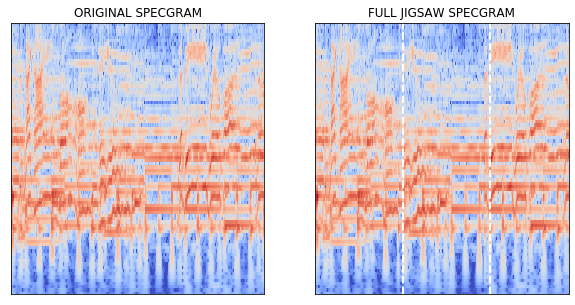

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
134/134680.mp3_cqt.npy    start second is 17.37    confidence is 0.4999


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
741
Complete Jigsaw Piece


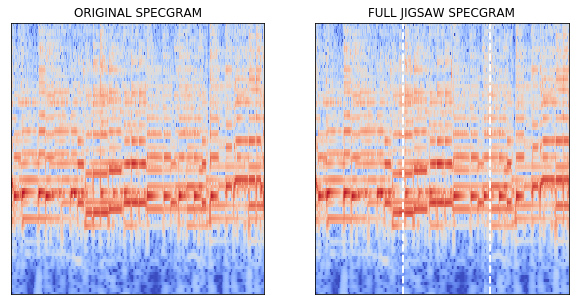

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
128/128466.mp3_cqt.npy    start second is 14.46    confidence is 0.5001


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
617
Complete Jigsaw Piece


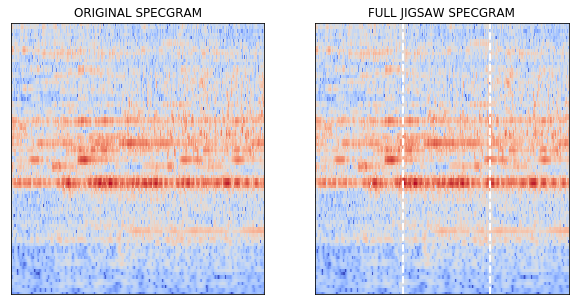

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
032/032120.mp3_cqt.npy    start second is 17.09    confidence is 0.4999


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [0, 1, 2]
729
Complete Jigsaw Piece


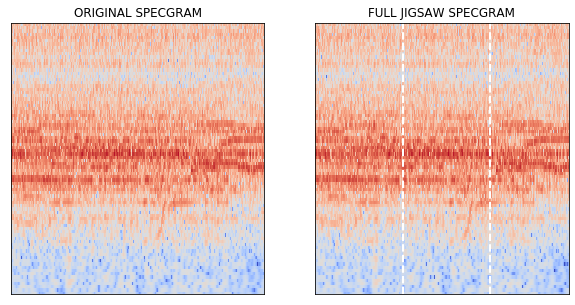

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

----------------------------------------------------------------------------------------------------
072/072710.mp3_cqt.npy    start second is 11.41    confidence is 0.5001


/home/sc6957/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:146: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')



Original


Jigsaw
Permutation: [1, 0, 2]
487
Complete Jigsaw Piece


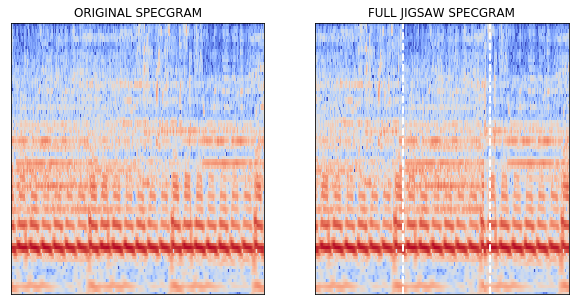

interactive(children=(Dropdown(description='i', options=(0, 1, 2), value=0), Output()), _dom_classes=('widget-…

In [50]:
print('For all the below examples model is most confused\n')
num_examples_to_show = 10
for i in range(5):
    print('-'*100)
    print(f"{confusing['file_name'].iloc[i]}\
    start second is {confusing['start_width'].iloc[i]/1280 * 30:.2f}\
    confidence is {confusing['class_1_prob'].iloc[i]:.4f}")
          
    start_width = confusing['start_width'].iloc[i]
    perm_map = confusing['perm_map'].iloc[i]
    waveform, _ = librosa.load(PATH_TO_AUDIO_FILES + confusing['file_name'].iloc[i][:-8], sr = SR)
    obj = ipd.Audio(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)], rate=SR)
    print()
    print('Original')
    ipd.display(obj)
    print('Jigsaw')
    print(f'Permutation: {perm_map}')
    chosen_split = waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)]
    print(start_width)
#     print(int(start_width*30/1280*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR))
#     print(int((NUM_SECONDS + start_width*30/1280)*SR) - int(start_width*30/1280*SR) +1)
#     print(chosen_split.shape)
    while len(chosen_split)%3 !=0:
        chosen_split=np.append(chosen_split,0)
    jigsaw_splits = [np.split(chosen_split, 3)][0]
    waveform_jigsaws = np.array([jigsaw_splits[x] for x in perm_map])

    print('Complete Jigsaw Piece')      
    waveform_jigsaw = np.concatenate(waveform_jigsaws)
#     print(waveform_jigsaw.shape)
    waveform_jigsaw = np.ascontiguousarray(waveform_jigsaw, dtype=np.float32)
    jigsaw_obj = ipd.Audio(waveform_jigsaw, rate=SR)
    ipd.display(jigsaw_obj)
    master.visualize_cqts(confusing['file_name'].iloc[i], 
                           start_width = start_width, perm_map=perm_map, display= True, figsize=(10,5))
          
    @interact
    def return_piece(i=range(3)):
          #for i,piece in enumerate(waveform_jigsaws):
          print(f'Position in Jigsaw {i}\nPosition in Original {perm_map[i]}')
          waveform_piece = np.ascontiguousarray(waveform_jigsaws[i], dtype=np.float32)
          waveform_piece_obj = ipd.Audio(waveform_piece, rate=SR)
          ipd.display(waveform_piece_obj)